In [1]:
import librosa

import IPython.display as ipd
import matplotlib.pyplot as plt
import numpy as np
from sklearn.model_selection import train_test_split 

from keras.models import Sequential
from keras.layers import Dense, Dropout, Activation
from keras.optimizers import Adam

I have simply taken some audio from youtube videos: 

Announcements: https://www.youtube.com/watch?v=PcNy0XqB3AE

Ambience: https://www.youtube.com/watch?v=gq1pZaPzefI

In [2]:
announcements, samplerate = librosa.load("announcements.wav", sr=None)
ambience, Fs = librosa.load("ambience.wav", sr=samplerate)
announcements = np.trim_zeros(announcements)
ambience = np.trim_zeros(ambience)

Lets explore the data a bit:

In [3]:
print(f"Sample rate matches: {Fs==samplerate}")
print(f"Announcements length: {announcements.shape[0]/samplerate:.2f} seconds")
print(f"Ambience length: {ambience.shape[0]/samplerate:.2f} seconds")

Sample rate matches: True
Announcements length: 273.25 seconds
Ambience length: 423.12 seconds


The resulting data is simply a np-array containing the amplitude as function of time:

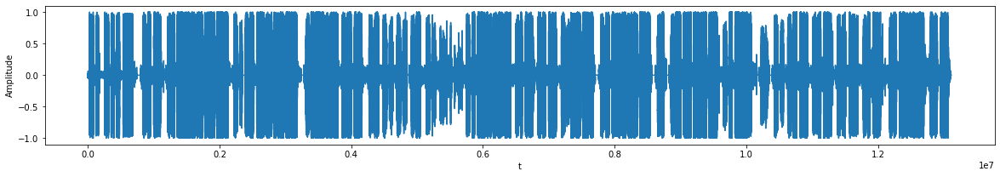

In [4]:
import matplotlib.pyplot as plt

plt.figure(figsize=(20,3))
plt.xlabel("t")
plt.ylabel("Amplitude")
plt.plot(announcements);

Listening to the audio, reveals that the audio is mostly clear. Probably not the most realistic examples.

In [5]:
ipd.Audio(announcements, rate=samplerate, normalize=False)

## Cut my audio into samples. This is my first step! *Humming in Papa Roach"

To start with, I reformat the audio data to form an array with shape (n, samplerate). That is each row is a sample of 1 second audio.

In [6]:
n_amb = ambience.shape[0]//samplerate
n_ann = announcements.shape[0]//samplerate
amb_samples = ambience[:n_amb*samplerate].reshape((-1, samplerate))
ann_samples = announcements[:n_ann*samplerate].reshape((-1, samplerate))

print(f"amb_samples.shape = {amb_samples.shape}")
print(f"ann_samples.shape = {ann_samples.shape}")

amb_samples.shape = (423, 48000)
ann_samples.shape = (273, 48000)


Lets be save and do a sanity check:

In [7]:
abort = False
for i in range(1,n_amb):
    tmp = np.array(amb_samples[i-1,:] == ambience[(i-1)*samplerate:i*samplerate])
    if not tmp.all().all():
        abort = True
        print("Samples dont match up! Abort mission!")
        
for i in range(1,n_ann):
    tmp = np.array(ann_samples[i-1,:] == announcements[(i-1)*samplerate:i*samplerate])
    if not tmp.all().all():
        abort = True
        print("Samples dont match up! Abort mission!")
        
if not abort:
    print("Everything matches up nicely!")

Everything matches up nicely!


## Shuffle the samples

In [8]:
np.random.shuffle(amb_samples)
np.random.shuffle(ann_samples)

Lets get some random ratios between 0.5 and 1.0 to do the mixing:

In [9]:
volume_ratio = 0.5*np.random.rand(ann_samples.shape[0]) + 0.5
print(f"volume_ratio > 0.5 == {(volume_ratio > 0.5).all()}")
print(f"volume_ratio < 1.0 == {(volume_ratio < 1.0).all()}") 
print(f"{volume_ratio.shape[0]} == {ann_samples.shape[0]}")

volume_ratio > 0.5 == True
volume_ratio < 1.0 == True
273 == 273


## Combine announcement and ambience samples

In [10]:
combined = amb_samples
target = np.zeros((amb_samples.shape[0],1))
for i in range(ann_samples.shape[0]):
    combined[i, :] = 0.5*(volume_ratio[i]*ann_samples[i, :] + amb_samples[i, :])
    target[i] = 1

Positive example: 

In [11]:
ipd.Audio(combined[0], rate=samplerate, normalize=False)

Negative example:

In [12]:
ipd.Audio(combined[-1], rate=samplerate, normalize=False)

## Standard feature extraction for audio data

See https://towardsdatascience.com/how-to-apply-machine-learning-and-deep-learning-methods-to-audio-analysis-615e286fcbbc

In [13]:
n_features = 40
combined_features = np.zeros((combined.shape[0],n_features))
for i in range(combined.shape[0]):
    combined_features[i] = np.mean(librosa.feature.mfcc(y=combined[i], sr=samplerate, n_mfcc=n_features).T, axis=0)
print(f"From {combined.shape} to {combined_features.shape}")

From (423, 48000) to (423, 40)


## Splitting the data into train and test sets

In [14]:
x_train, x_test, y_train, y_test = train_test_split(combined_features, target, test_size=0.2, random_state = 42)
print(f"x_train.shape = {x_train.shape}")
print(f"y_train.shape = {y_train.shape}")
print(f"x_test.shape = {x_test.shape}")
print(f"y_test.shape = {y_test.shape}")

x_train.shape = (338, 40)
y_train.shape = (338, 1)
x_test.shape = (85, 40)
y_test.shape = (85, 1)


In [15]:
model = Sequential()
model.add(Dense(256, input_dim=n_features, activation="relu"))
model.add(Dropout(0.5))
model.add(Dense(256, activation="relu"))
model.add(Dropout(0.5))
model.add(Dense(1, activation="sigmoid"))

model.compile(loss="binary_crossentropy", metrics=["accuracy"], optimizer="adam")

model.fit(x_train, y_train, epochs=1000, batch_size=16)

Epoch 1/1000
22/22 [==============================] - 0s 2ms/step - loss: 10.1152 - accuracy: 0.5503
Epoch 2/1000
22/22 [==============================] - 0s 2ms/step - loss: 7.6934 - accuracy: 0.5680
Epoch 3/1000
22/22 [==============================] - 0s 2ms/step - loss: 4.8539 - accuracy: 0.6036
Epoch 4/1000
22/22 [==============================] - 0s 2ms/step - loss: 3.7628 - accuracy: 0.6213
Epoch 5/1000
22/22 [==============================] - 0s 2ms/step - loss: 3.1414 - accuracy: 0.7160
Epoch 6/1000
22/22 [==============================] - 0s 2ms/step - loss: 2.2427 - accuracy: 0.6893
Epoch 7/1000
22/22 [==============================] - 0s 2ms/step - loss: 1.6867 - accuracy: 0.7041
Epoch 8/1000
22/22 [==============================] - 0s 2ms/step - loss: 1.5372 - accuracy: 0.7101
Epoch 9/1000
22/22 [==============================] - 0s 2ms/step - loss: 1.2027 - accuracy: 0.7426
Epoch 10/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.9455 - accuracy: 0.781

22/22 [==============================] - 0s 2ms/step - loss: 0.0899 - accuracy: 0.9734
Epoch 83/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.1181 - accuracy: 0.9438
Epoch 84/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.1682 - accuracy: 0.9497
Epoch 85/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.1411 - accuracy: 0.9527
Epoch 86/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0985 - accuracy: 0.9586
Epoch 87/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0930 - accuracy: 0.9645
Epoch 88/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0895 - accuracy: 0.9704
Epoch 89/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.1312 - accuracy: 0.9497
Epoch 90/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.1174 - accuracy: 0.9467
Epoch 91/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.1597 - accuracy: 0.9438
Epoc

22/22 [==============================] - 0s 2ms/step - loss: 0.0810 - accuracy: 0.9645
Epoch 163/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0873 - accuracy: 0.9645
Epoch 164/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0604 - accuracy: 0.9822
Epoch 165/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0919 - accuracy: 0.9645
Epoch 166/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0919 - accuracy: 0.9704
Epoch 167/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0468 - accuracy: 0.9882
Epoch 168/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0499 - accuracy: 0.9852
Epoch 169/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0715 - accuracy: 0.9645
Epoch 170/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0719 - accuracy: 0.9734
Epoch 171/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0319 - accuracy: 0.

22/22 [==============================] - 0s 2ms/step - loss: 0.0705 - accuracy: 0.9793
Epoch 243/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0633 - accuracy: 0.9704
Epoch 244/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0468 - accuracy: 0.9822
Epoch 245/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0483 - accuracy: 0.9793
Epoch 246/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0512 - accuracy: 0.9882
Epoch 247/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0336 - accuracy: 0.9882
Epoch 248/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0618 - accuracy: 0.9734
Epoch 249/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0825 - accuracy: 0.9704
Epoch 250/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0643 - accuracy: 0.9704
Epoch 251/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0381 - accuracy: 0.

22/22 [==============================] - 0s 2ms/step - loss: 0.0444 - accuracy: 0.9822
Epoch 323/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0300 - accuracy: 0.9911
Epoch 324/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0604 - accuracy: 0.9763
Epoch 325/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0361 - accuracy: 0.9852
Epoch 326/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0312 - accuracy: 0.9882
Epoch 327/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0175 - accuracy: 0.9941
Epoch 328/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0578 - accuracy: 0.9763
Epoch 329/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0760 - accuracy: 0.9645
Epoch 330/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0693 - accuracy: 0.9852
Epoch 331/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0809 - accuracy: 0.

22/22 [==============================] - 0s 2ms/step - loss: 0.0237 - accuracy: 0.9941
Epoch 403/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0187 - accuracy: 0.9941
Epoch 404/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0428 - accuracy: 0.9911
Epoch 405/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0841 - accuracy: 0.9822
Epoch 406/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0236 - accuracy: 0.9911
Epoch 407/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0352 - accuracy: 0.9882
Epoch 408/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0460 - accuracy: 0.9822
Epoch 409/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0500 - accuracy: 0.9852
Epoch 410/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0313 - accuracy: 0.9882
Epoch 411/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0202 - accuracy: 0.

22/22 [==============================] - 0s 2ms/step - loss: 0.0165 - accuracy: 0.9970
Epoch 483/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0069 - accuracy: 0.9970
Epoch 484/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0535 - accuracy: 0.9941
Epoch 485/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0331 - accuracy: 0.9882
Epoch 486/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0318 - accuracy: 0.9882
Epoch 487/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0375 - accuracy: 0.9882
Epoch 488/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0273 - accuracy: 0.9911
Epoch 489/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0274 - accuracy: 0.9882
Epoch 490/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0137 - accuracy: 0.9970
Epoch 491/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0274 - accuracy: 0.

22/22 [==============================] - 0s 2ms/step - loss: 0.0295 - accuracy: 0.9941
Epoch 563/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0379 - accuracy: 0.9882
Epoch 564/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0305 - accuracy: 0.9911
Epoch 565/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0262 - accuracy: 0.9941
Epoch 566/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0180 - accuracy: 0.9941
Epoch 567/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0444 - accuracy: 0.9822
Epoch 568/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0568 - accuracy: 0.9763
Epoch 569/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0407 - accuracy: 0.9822
Epoch 570/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0670 - accuracy: 0.9763
Epoch 571/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0574 - accuracy: 0.

22/22 [==============================] - 0s 2ms/step - loss: 0.0210 - accuracy: 0.9970
Epoch 643/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0234 - accuracy: 0.9911
Epoch 644/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0309 - accuracy: 0.9941
Epoch 645/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0295 - accuracy: 0.9882
Epoch 646/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0455 - accuracy: 0.9882
Epoch 647/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0439 - accuracy: 0.9822
Epoch 648/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0638 - accuracy: 0.9793
Epoch 649/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0524 - accuracy: 0.9822
Epoch 650/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0356 - accuracy: 0.9852
Epoch 651/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0505 - accuracy: 0.

22/22 [==============================] - 0s 2ms/step - loss: 0.0281 - accuracy: 0.9941
Epoch 723/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0363 - accuracy: 0.9852
Epoch 724/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0251 - accuracy: 0.9911
Epoch 725/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0668 - accuracy: 0.9763
Epoch 726/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0359 - accuracy: 0.9882
Epoch 727/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0388 - accuracy: 0.9852
Epoch 728/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0450 - accuracy: 0.9882
Epoch 729/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0646 - accuracy: 0.9822
Epoch 730/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0546 - accuracy: 0.9822
Epoch 731/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0494 - accuracy: 0.

22/22 [==============================] - 0s 2ms/step - loss: 0.0265 - accuracy: 0.9941
Epoch 803/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0419 - accuracy: 0.9882
Epoch 804/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0805 - accuracy: 0.9704
Epoch 805/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0379 - accuracy: 0.9882
Epoch 806/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0164 - accuracy: 0.9970
Epoch 807/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0554 - accuracy: 0.9793
Epoch 808/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0172 - accuracy: 0.9970
Epoch 809/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0174 - accuracy: 0.9970
Epoch 810/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0286 - accuracy: 0.9911
Epoch 811/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0387 - accuracy: 0.

22/22 [==============================] - 0s 2ms/step - loss: 0.0404 - accuracy: 0.9852
Epoch 883/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0393 - accuracy: 0.9882
Epoch 884/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0531 - accuracy: 0.9763
Epoch 885/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0091 - accuracy: 0.9970
Epoch 886/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0304 - accuracy: 0.9911
Epoch 887/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0347 - accuracy: 0.9882
Epoch 888/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0292 - accuracy: 0.9911
Epoch 889/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0439 - accuracy: 0.9793
Epoch 890/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0784 - accuracy: 0.9734
Epoch 891/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0416 - accuracy: 0.

22/22 [==============================] - 0s 2ms/step - loss: 0.0568 - accuracy: 0.9822
Epoch 963/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0955 - accuracy: 0.9615
Epoch 964/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.1023 - accuracy: 0.9615
Epoch 965/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0805 - accuracy: 0.9793
Epoch 966/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.1037 - accuracy: 0.9734
Epoch 967/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0510 - accuracy: 0.9822
Epoch 968/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0471 - accuracy: 0.9852
Epoch 969/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0569 - accuracy: 0.9822
Epoch 970/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0672 - accuracy: 0.9734
Epoch 971/1000
22/22 [==============================] - 0s 2ms/step - loss: 0.0488 - accuracy: 0.

In [16]:
_, accuracy = model.evaluate(x_train, y_train, verbose=False)
print(f"Training accuracy: {accuracy*100}%")
_, accuracy = model.evaluate(x_test, y_test, verbose=False)
print(f"Test accuracy: {accuracy*100}%")
print(model.predict(x_test).T.astype(int))
print(y_test.T.astype(int))

Training accuracy: 99.7041404247284%
Test accuracy: 92.9411768913269%
[[1 0 0 0 0 1 0 1 1 0 1 1 0 0 0 0 1 1 0 1 1 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0
  1 0 0 0 1 1 0 1 1 0 0 0 0 1 1 1 1 0 1 0 0 0 1 0 0 1 1 0 0 0 0 0 1 0 1 0
  0 0 0 1 0 1 0 0 0 0 1 1 1]]
[[1 0 1 0 0 1 1 1 1 1 1 1 0 1 0 0 1 1 1 1 1 1 0 1 1 0 1 0 1 1 0 1 1 1 0 1
  1 1 1 0 1 1 0 1 1 0 1 0 0 1 1 1 1 1 1 0 0 0 1 1 0 1 1 0 1 0 0 1 1 0 1 0
  0 0 1 1 0 1 0 0 1 0 1 1 1]]


Considering our small training set and little effort in tuning any parameters these accuracies look good already.

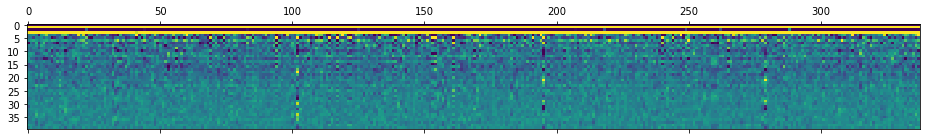

In [17]:
plt.matshow(x_train.T, vmin=-20, vmax=20 )

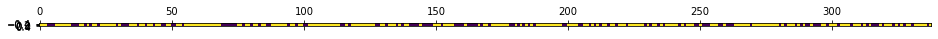

In [18]:
plt.matshow(y_train.T )

## Lets sanity check with a different classifier:

In [19]:
from sklearn.ensemble import RandomForestClassifier
clf = RandomForestClassifier(max_depth=2, random_state=0, verbose=True)
clf.fit(x_train, y_train)

<ipython-input-19-7bbe3989ca63>:3: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  clf.fit(x_train, y_train)
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 100 out of 100 | elapsed:    0.0s finished


RandomForestClassifier(max_depth=2, random_state=0, verbose=True)

In [20]:
clf.score(x_test, y_test)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 100 out of 100 | elapsed:    0.0s finished


0.7764705882352941